#### Question Answering Chatbot

Once we retrieve the documents that are relevant based on Question . We will use this Documents and Question asked and will pass it into LLM and will ask it to answer the question.

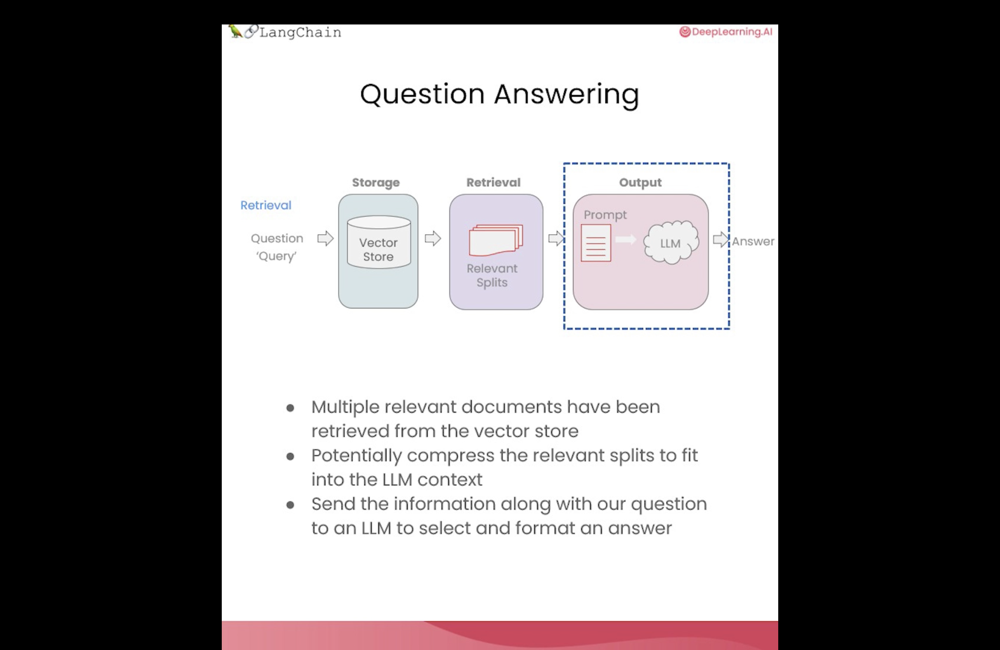

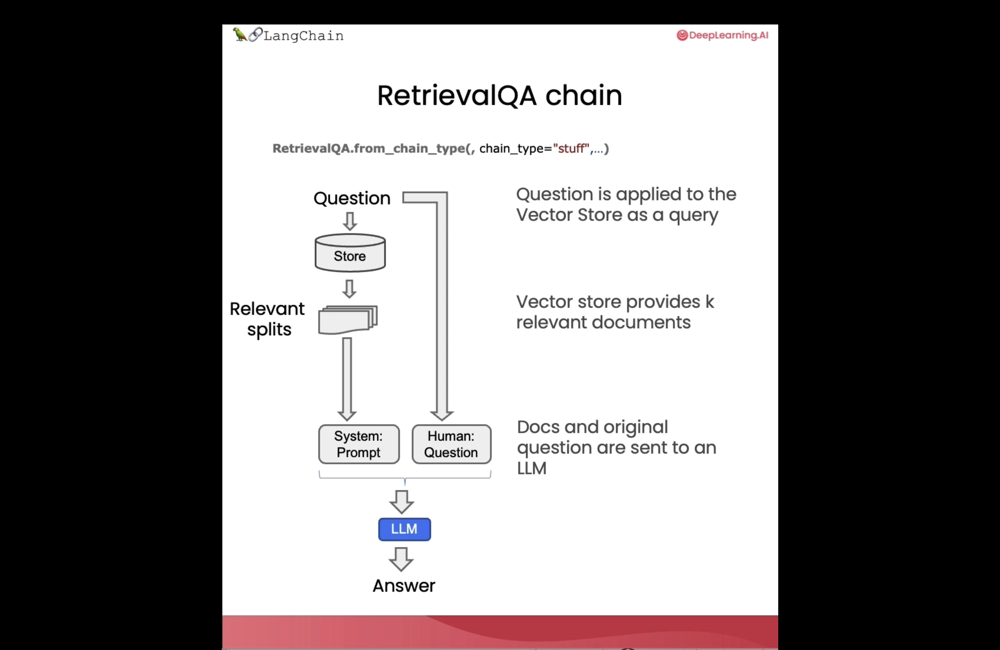

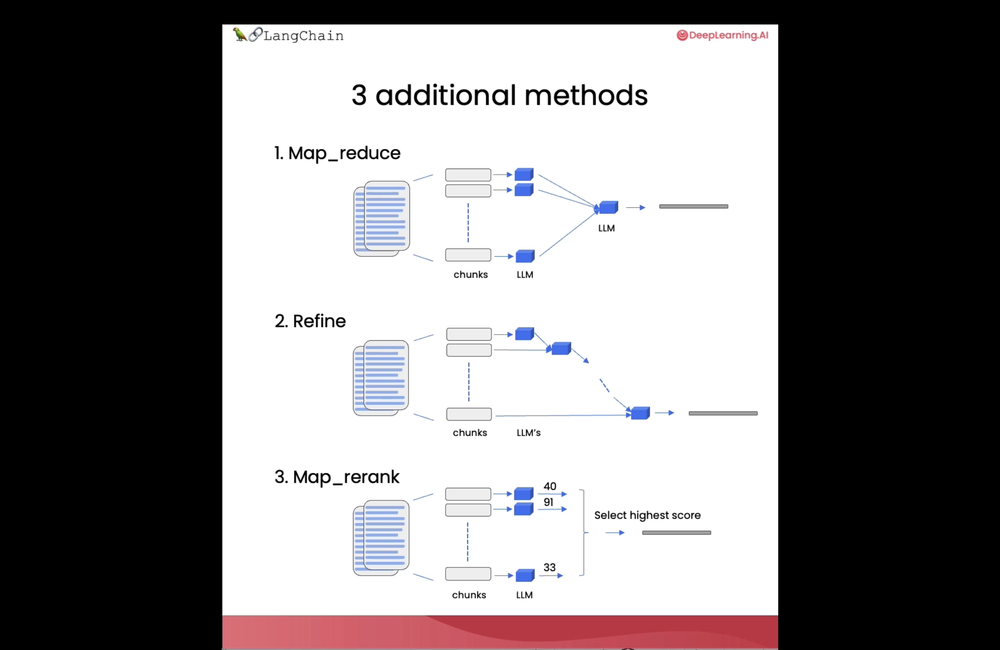

In [ ]:
import os
import openai
import sys
sys.path.append('../..')

from dotenv import load_dotenv, find_dotenv
_ = load_dotenv(find_dotenv()) # read local .env file

openai.api_key  = os.environ['OPENAI_API_KEY']

The code below was added to assign the openai LLM version filmed until it is deprecated, currently in Sept 2023. 
LLM responses can often vary, but the responses may be significantly different when using a different model version.

In [1]:
import datetime
current_date = datetime.datetime.now().date()
if current_date < datetime.date(2023, 9, 2):
    llm_name = "gpt-3.5-turbo-0301"
else:
    llm_name = "gpt-3.5-turbo"
print(llm_name)

gpt-3.5-turbo


In [2]:
from langchain.vectorstores import Chroma
from langchain.embeddings.openai import OpenAIEmbeddings
persist_directory = 'docs/chroma/'
embedding = OpenAIEmbeddings()
vectordb = Chroma(persist_directory=persist_directory, embedding_function=embedding)
print(vectordb._collection.count())

209


In [3]:
question = "What are major topics for this class?"
docs = vectordb.similarity_search(question,k=3)
docs

[Document(page_content="statistics for a while or maybe algebra, we'll go over those in the discussion sections as a \nrefresher for those of you that want one.  \nLater in this quarter, we'll also use the disc ussion sections to go over extensions for the \nmaterial that I'm teaching in the main lectur es. So machine learning is a huge field, and \nthere are a few extensions that we really want  to teach but didn't have time in the main \nlectures for.", metadata={'page': 8, 'source': 'docs/cs229_lectures/MachineLearning-Lecture01.pdf'}),
 Document(page_content="statistics for a while or maybe algebra, we'll go over those in the discussion sections as a \nrefresher for those of you that want one.  \nLater in this quarter, we'll also use the disc ussion sections to go over extensions for the \nmaterial that I'm teaching in the main lectur es. So machine learning is a huge field, and \nthere are a few extensions that we really want  to teach but didn't have time in the main \nlectures f

In [4]:
from langchain.chat_models import ChatOpenAI
llm = ChatOpenAI(model_name=llm_name, temperature=0)

### RetrievalQA chain

In [5]:
from langchain.chains import RetrievalQA
qa_chain = RetrievalQA.from_chain_type(
    llm,
    retriever=vectordb.as_retriever()
)
result = qa_chain({"query": question})
result["result"]

'The major topics for this class are machine learning and its various subfields.'

#### Prompt

In [6]:
from langchain.prompts import PromptTemplate

# Build prompt
template = """Use the following pieces of context to answer the question at the end. If you don't know the answer, just say that you don't know, don't try to make up an answer. Use three sentences maximum. Keep the answer as concise as possible. Always say "thanks for asking!" at the end of the answer. 
{context}
Question: {question}
Helpful Answer:"""
QA_CHAIN_PROMPT = PromptTemplate.from_template(template)
QA_CHAIN_PROMPT


PromptTemplate(input_variables=['context', 'question'], template='Use the following pieces of context to answer the question at the end. If you don\'t know the answer, just say that you don\'t know, don\'t try to make up an answer. Use three sentences maximum. Keep the answer as concise as possible. Always say "thanks for asking!" at the end of the answer. \n{context}\nQuestion: {question}\nHelpful Answer:')

In [7]:
# Run chain
qa_chain = RetrievalQA.from_chain_type(
    llm,
    retriever=vectordb.as_retriever(),
    return_source_documents=True,
    chain_type_kwargs={"prompt": QA_CHAIN_PROMPT}
)

In [8]:
question = "Is probability a class topic?"
result = qa_chain({"query": question})

In [9]:
result["result"]

'Yes, probability is a class topic. Thanks for asking!'

In [10]:
result["source_documents"][0]

Document(page_content="of this class will not be very program ming intensive, although we will do some \nprogramming, mostly in either MATLAB or Octa ve. I'll say a bit more about that later.  \nI also assume familiarity with basic proba bility and statistics. So most undergraduate \nstatistics class, like Stat 116 taught here at Stanford, will be more than enough. I'm gonna \nassume all of you know what ra ndom variables are, that all of you know what expectation \nis, what a variance or a random variable is. And in case of some of you, it's been a while \nsince you've seen some of this material. At some of the discussion sections, we'll actually \ngo over some of the prerequisites, sort of as  a refresher course under prerequisite class. \nI'll say a bit more about that later as well.  \nLastly, I also assume familiarity with basi c linear algebra. And again, most undergraduate \nlinear algebra courses are more than enough. So if you've taken courses like Math 51, \n103, Math 113 or 

### RetrievalQA chain types

In [ ]:
### By default stuff technique is used 

qa_chain_mr = RetrievalQA.from_chain_type(
    llm,
    retriever=vectordb.as_retriever(),
    chain_type="map_reduce"
)

result = qa_chain_mr({"query": question})
result["result"]

When you use Map Reduce . There are 2 problems 
- Takes too much time 
- Result is not clear 

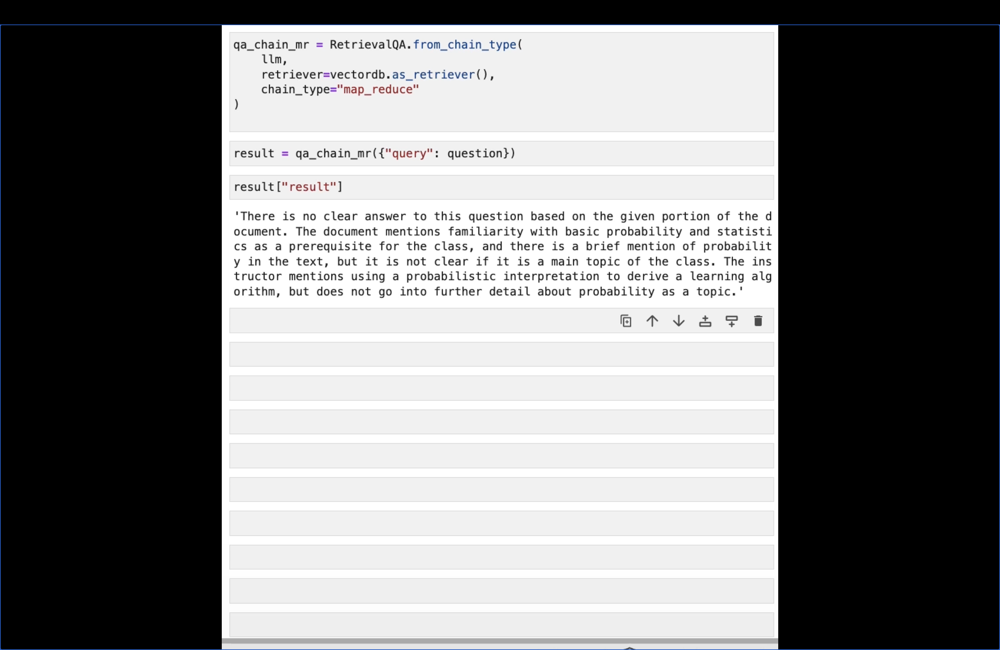

If you wish to experiment on the `LangChain plus platform`:

 * Go to [langchain plus platform](https://www.langchain.plus/) and sign up
 * Create an API key from your account's settings
 * Use this API key in the code below   
 * uncomment the code  
 Note, the endpoint in the video differs from the one below. Use the one below.

In [ ]:
#import os
#os.environ["LANGCHAIN_TRACING_V2"] = "true"
#os.environ["LANGCHAIN_ENDPOINT"] = "https://api.langchain.plus"
#os.environ["LANGCHAIN_API_KEY"] = "..." # replace dots with your api key

In [ ]:
qa_chain_mr = RetrievalQA.from_chain_type(
    llm,
    retriever=vectordb.as_retriever(),
    chain_type="map_reduce"
)
result = qa_chain_mr({"query": question})
result["result"]

4 Seperate calls are made to language model 

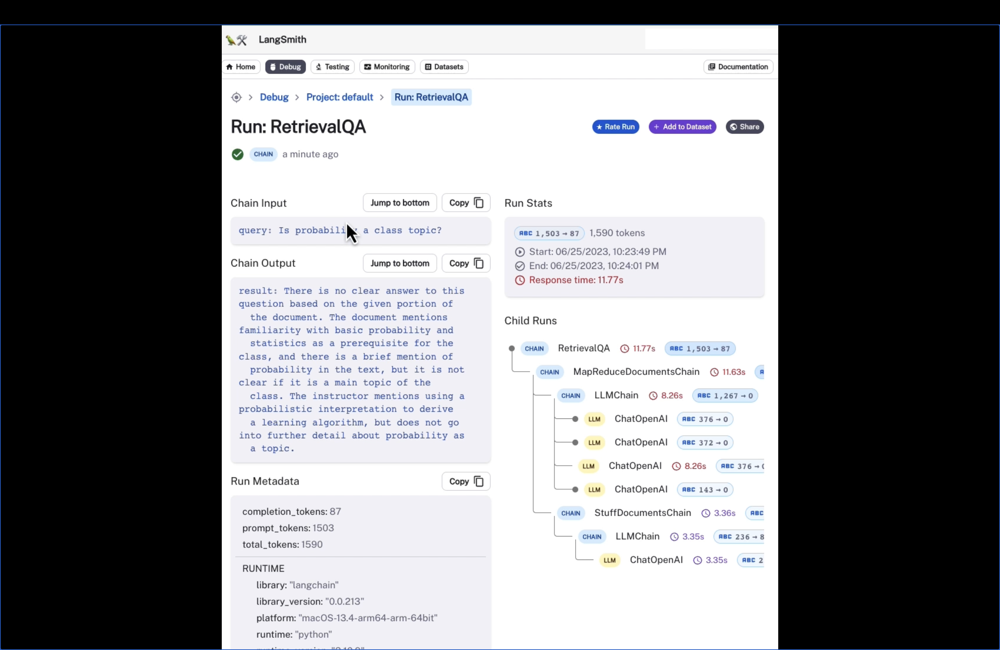

We can see input and output for each llm call

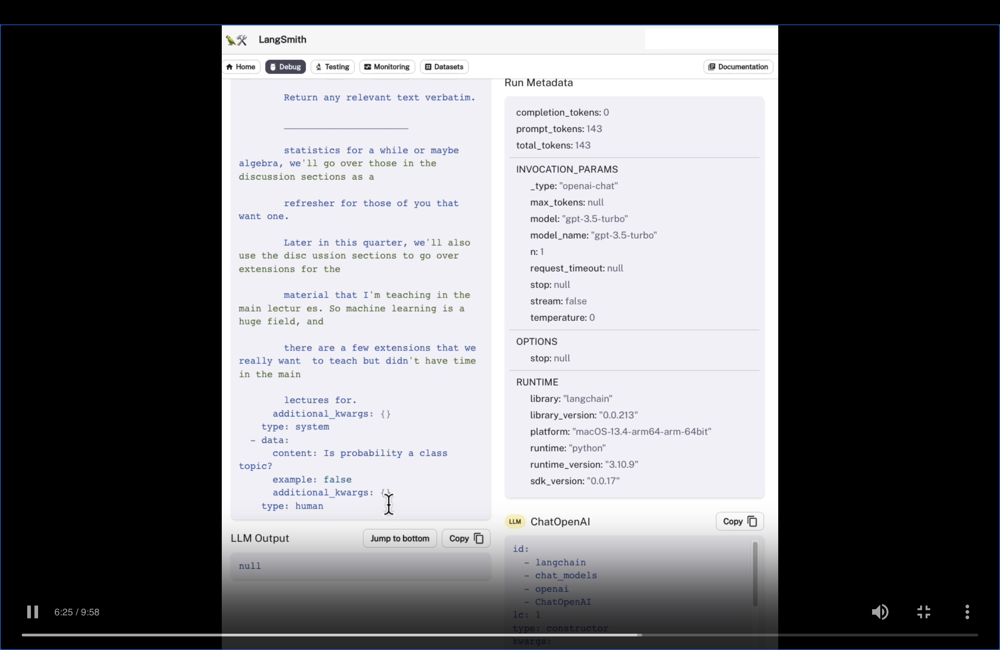

Once we get output from each of the 4 LLMS . We are combining all of them and calling LLM Again

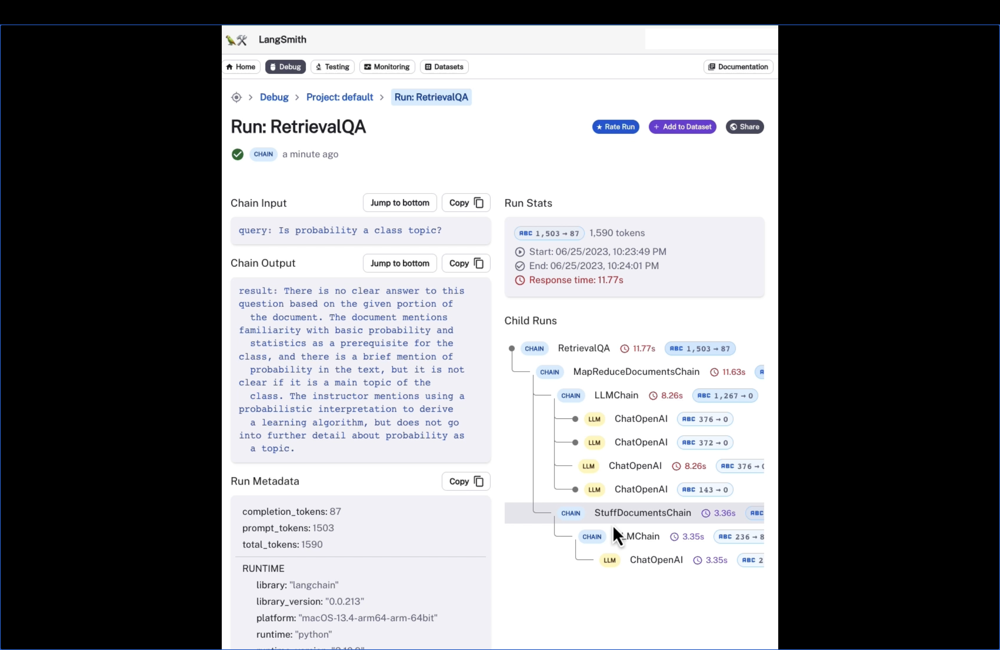

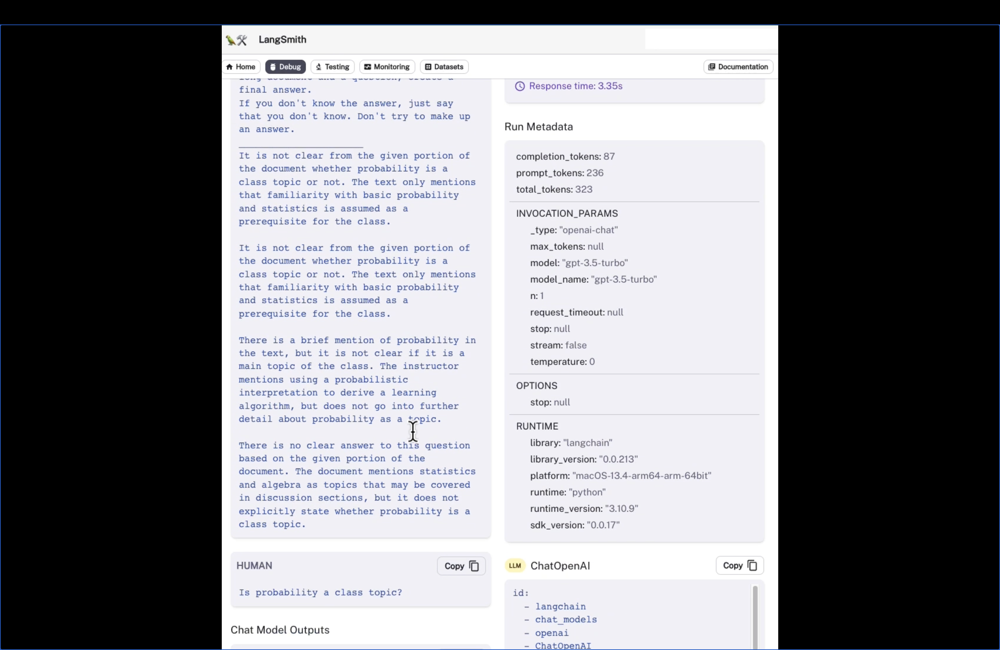

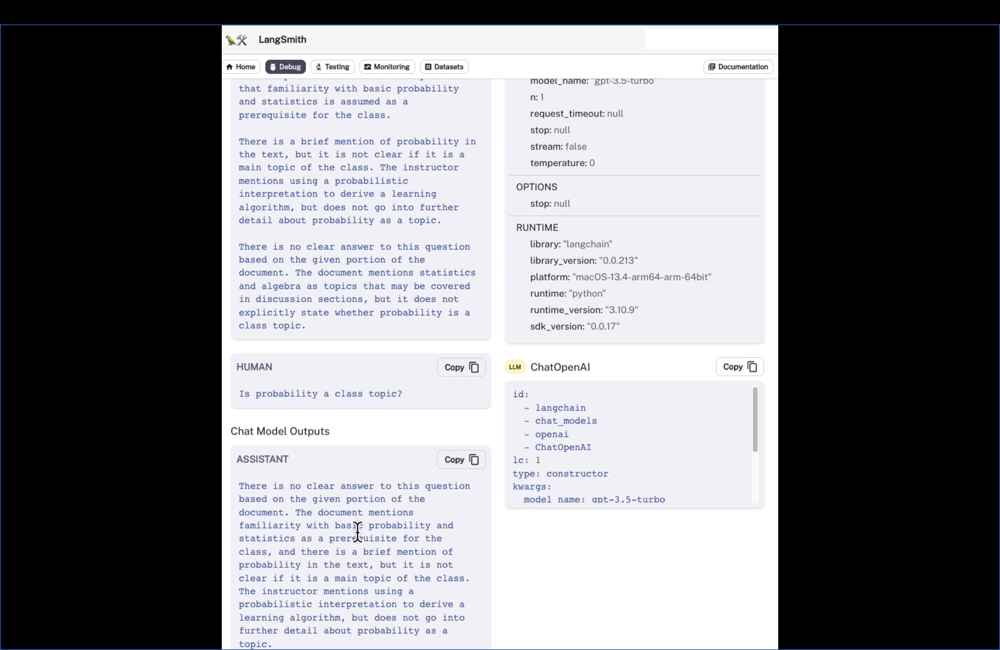

Chain type - Refine 

In [ ]:
qa_chain_mr = RetrievalQA.from_chain_type(
    llm,
    retriever=vectordb.as_retriever(),
    chain_type="refine"
)
result = qa_chain_mr({"query": question})
result["result"]

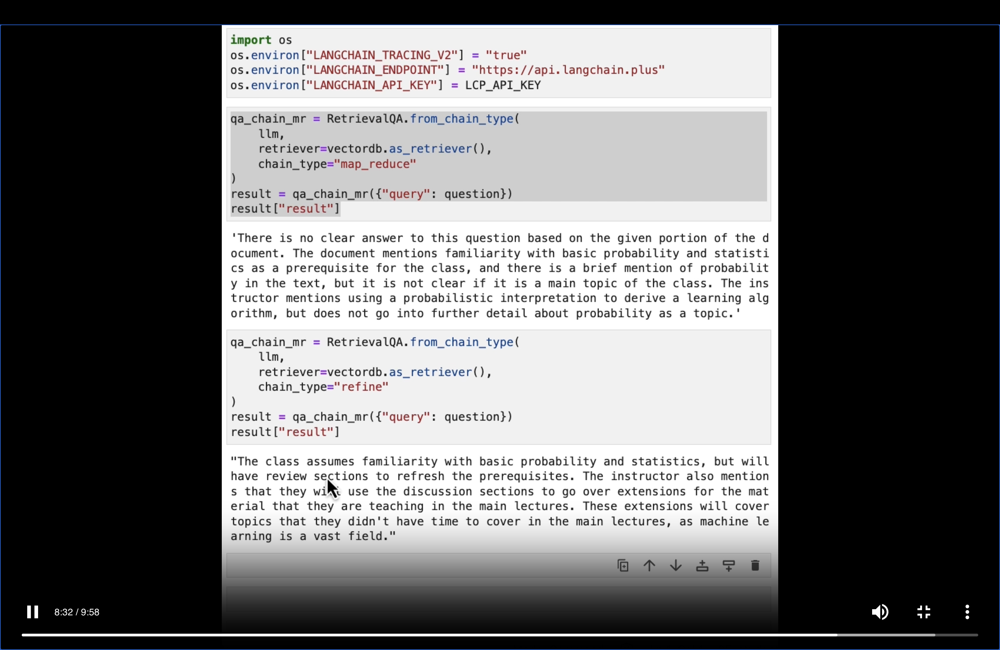

4 sequential calls to  chain . Which further calls LLM

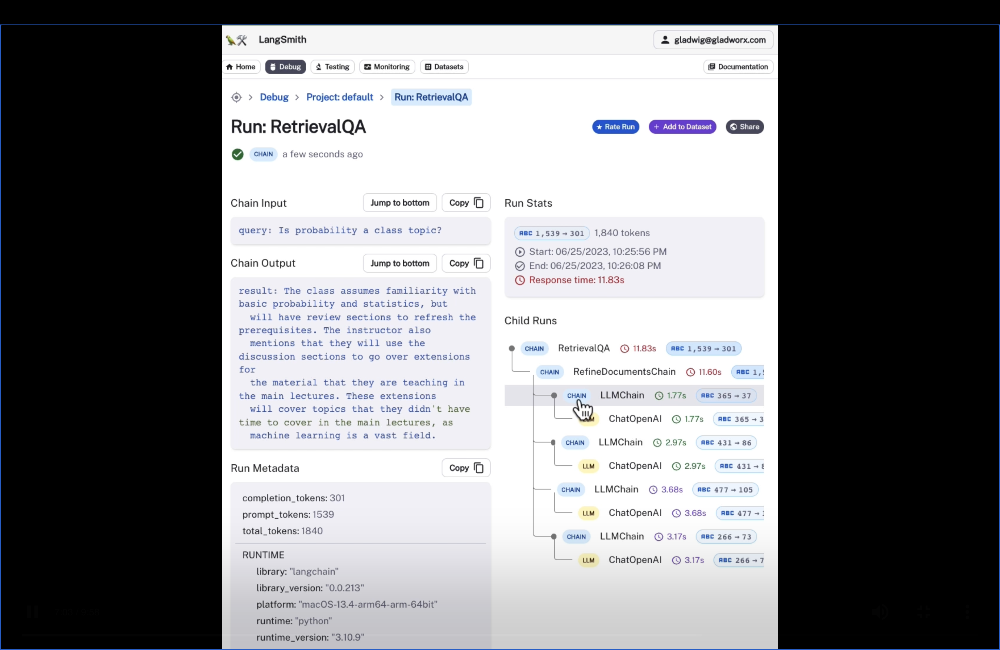

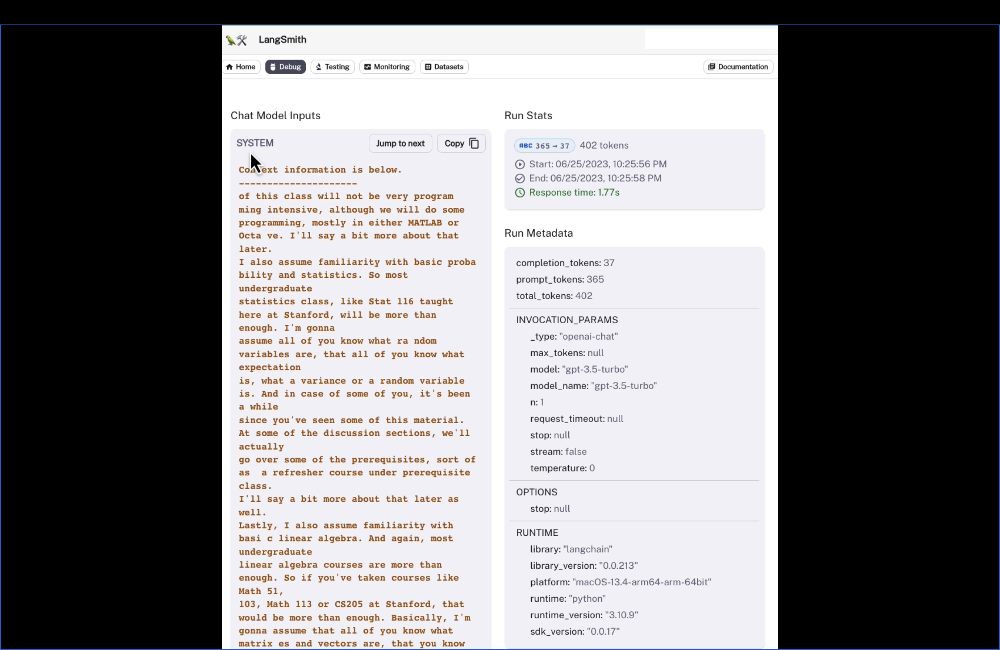

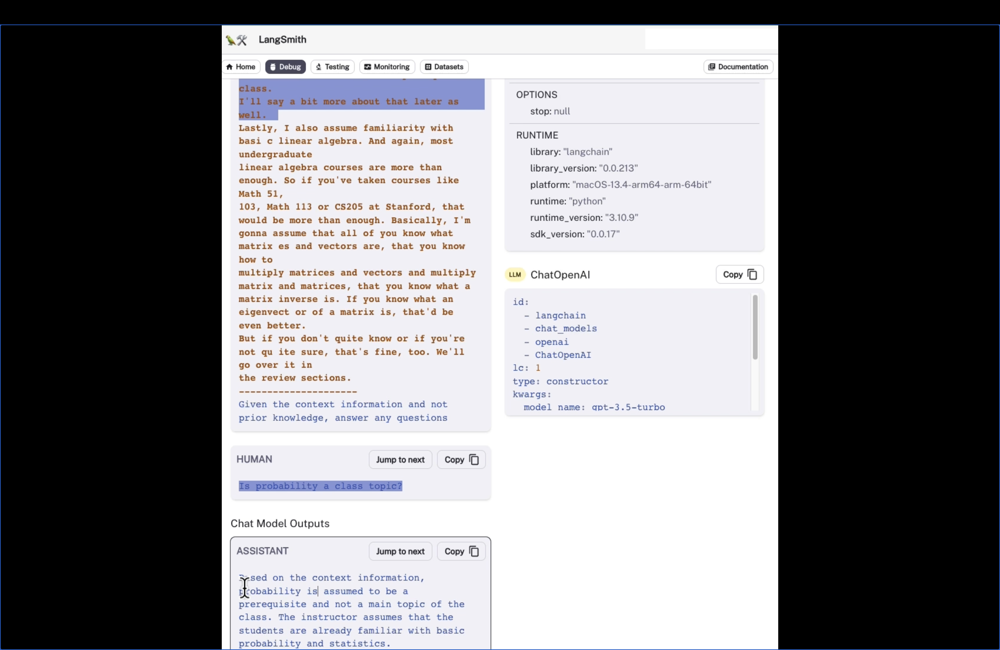

Lets check next call 

It combine previous data from first response 

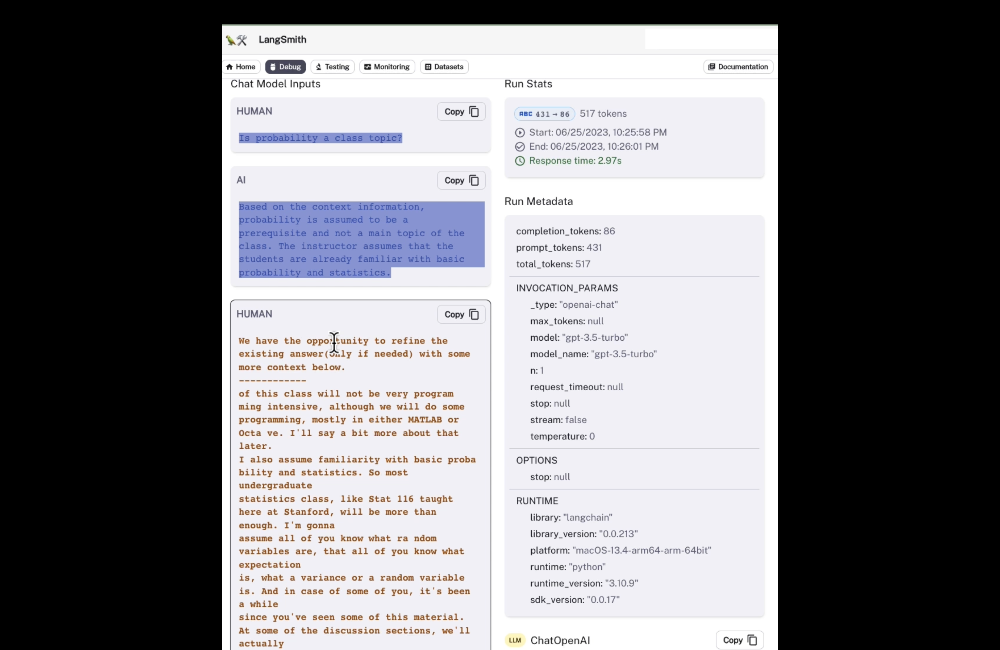

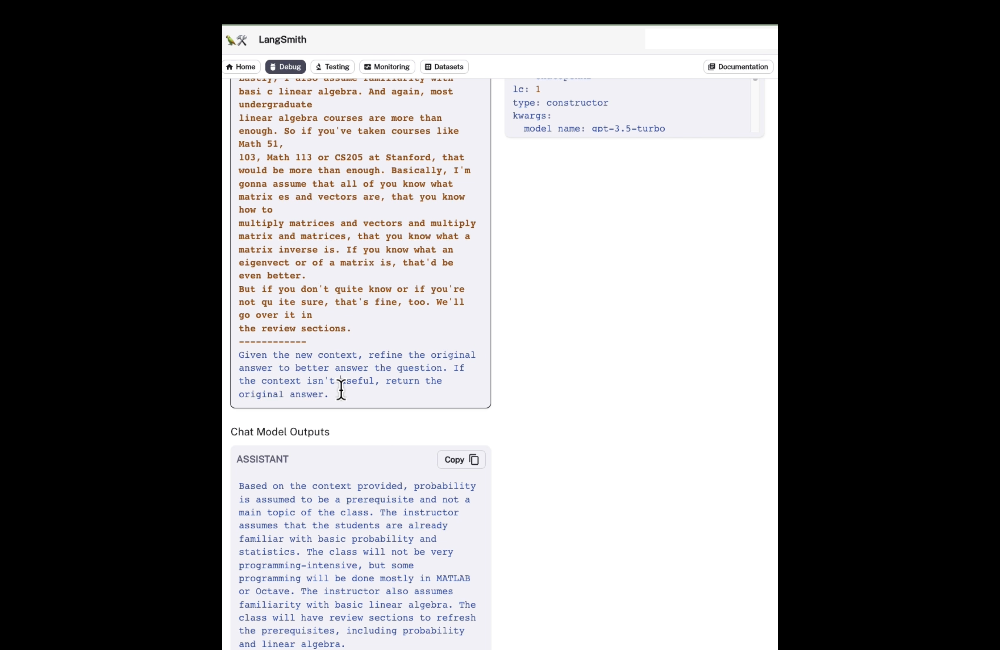

Similarly it will be called for each LLM CHAIN 

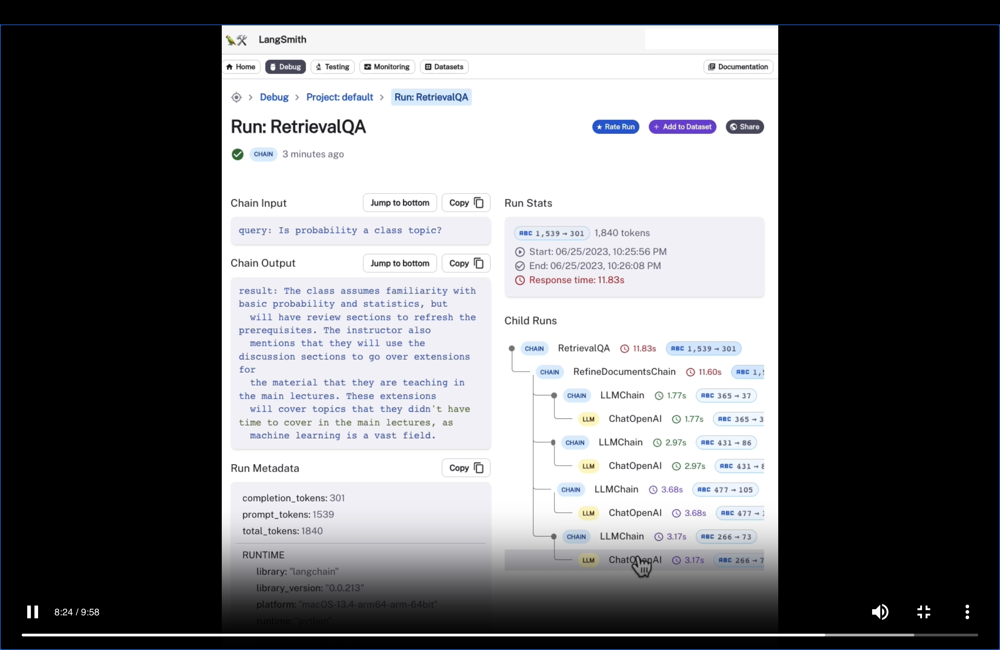

### RetrievalQA limitations
 
QA fails to preserve conversational history.

In [13]:
qa_chain = RetrievalQA.from_chain_type(
    llm,
    retriever=vectordb.as_retriever()
)
question = "Is probability a class topic?"
result = qa_chain({"query": question})
result["result"]

'Yes, probability is a topic that will be covered in this class. The instructor assumes familiarity with basic probability and statistics.'

In [14]:
question = "why are those prerequesites needed?"
result = qa_chain({"query": question})
result["result"]

### Answer below doesnt not relate to previous question asked.

## Retrieval QA does not have Conversational History

'The prerequisites are needed because they provide the foundational knowledge and skills necessary to understand and apply the concepts and techniques taught in the class. \n\nBasic knowledge of computer science and computer skills is important because machine learning algorithms often involve programming and working with data. Understanding big-O notation is essential for analyzing the efficiency and scalability of algorithms.\n\nFamiliarity with probability and statistics is necessary because machine learning involves making predictions and analyzing data, which requires understanding concepts such as random variables, expectation, and variance.\n\nBasic knowledge of linear algebra is important because many machine learning algorithms involve manipulating matrices and vectors. Understanding concepts such as matrix multiplication, matrix inverse, and eigenvectors is crucial for working with these algorithms.\n\nOverall, these prerequisites ensure that students have the necessary backg